In [7]:
import pandas as pd
import numpy as np
import plotly.express as px


In [34]:
df = pd.read_csv('data/generacion_conjunto.csv', index_col=0, parse_dates=True)
# df.index = pd.to_datetime(df.index, format='ISO8601', utc=True)
df = df.asfreq('h')
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 113207 entries, 2011-01-01 00:00:00+00:00 to 2023-11-30 22:00:00+00:00
Freq: H
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   solar   113201 non-null  float64
 1   eolica  113201 non-null  float64
dtypes: float64(2)
memory usage: 2.6 MB


In [37]:
fig = px.line(df, x=df.index, y='solar', title='Solar')
fig.show()

In [38]:
fig = px.line(df, x=df.index, y='eolica', title='Eólica')
fig.show()

In [39]:
df_clean = df[df['solar']!=0]
df_clean = df_clean.dropna()

In [40]:
cov = df_clean.cov()
corr = cov.iloc[0,1]/np.sqrt(cov.iloc[0,0]*cov.iloc[1,1])
print("Correlación:",corr)

Correlación: -0.1310075359850205


## Seasonality

In [41]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

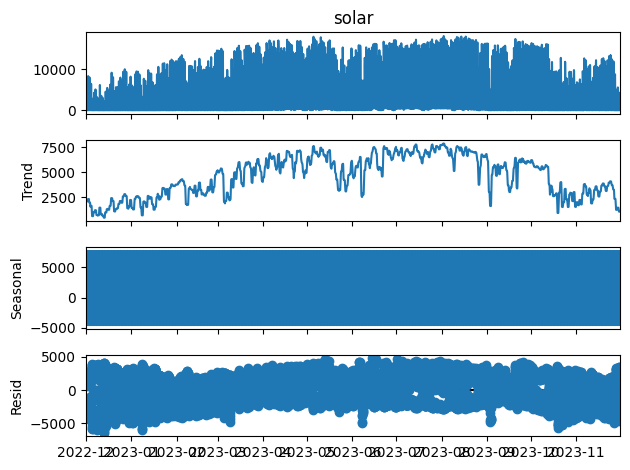

In [45]:
sd_solar = seasonal_decompose(df_clean['solar'].iloc[-365*24:], model='additive', period=24)
sd_solar.plot()
plt.show()

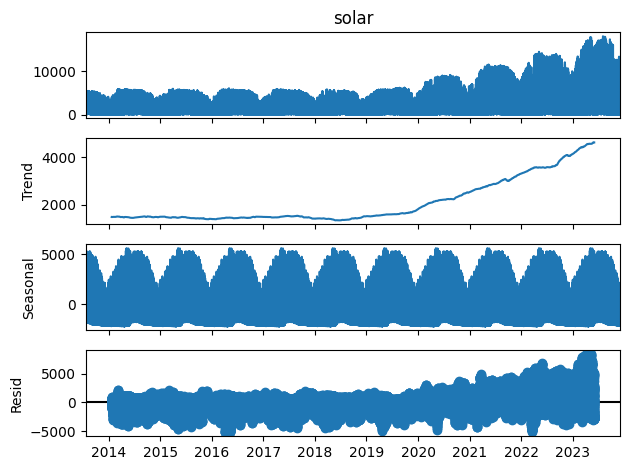

In [46]:
sd_solar = seasonal_decompose(df_clean['solar'], model='additive', period=365*24)
sd_solar.plot()
plt.show()

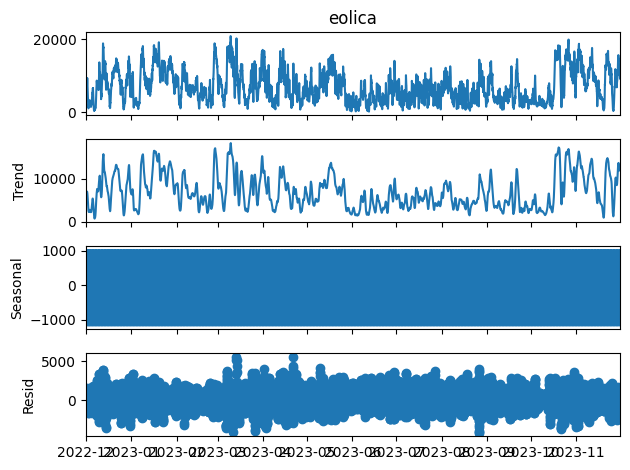

In [48]:
sd_eolica = seasonal_decompose(df_clean['eolica'].iloc[-365*24:], model='additive', period=24)
sd_eolica.plot()
plt.show()

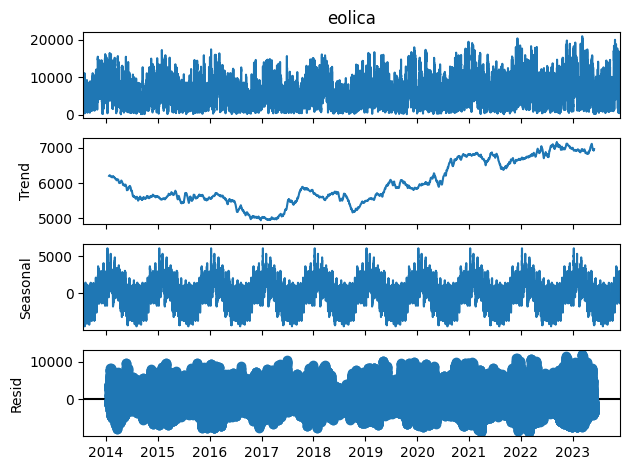

In [50]:
sd_eolica = seasonal_decompose(df_clean['eolica'], model='additive', period=365*24)
sd_eolica.plot()
plt.show()